# RNA Velocity for T-Cells Second Run
## Import seurat loom and velocyto loom
* velocyto was run on BAM file produced by CellRanger Count
* SeuratDisk was used to export Seurat object as loom file

### import libraries

In [13]:
import scanpy as sc
import scvelo as scv
import pandas as pd
import numpy as np

### Set default figure parameters of scVelo

In [14]:
scv.set_figure_params()

In [3]:
adata_rt1 = scv.read("/Users/Oliver.Eichmueller/velocyto_test/rt-1/Output/possorted_genome_bam_X0WAR.loom")
adata_rt2 = scv.read("/Users/Oliver.Eichmueller/velocyto_test/rt-2/Output/possorted_genome_bam_A5Y2F.loom")
adata_rtc41 = scv.read("/Users/Oliver.Eichmueller/velocyto_test/rtc4-1/Output/possorted_genome_bam_FGRIQ.loom")
adata_rtc42 = scv.read("/Users/Oliver.Eichmueller/velocyto_test/rtc4-2/Output/possorted_genome_bam_RP23L.loom")
adata_untr = scv.read("/Users/Oliver.Eichmueller/velocyto_test/untreated/Output/possorted_genome_bam_U5LH0.loom")

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [4]:
adata_rt1.var_names_make_unique()
adata_rt2.var_names_make_unique()
adata_rtc41.var_names_make_unique()
adata_rtc42.var_names_make_unique()
adata_untr.var_names_make_unique()

In [5]:
scv.utils.clean_obs_names(adata_rt1)
scv.utils.clean_obs_names(adata_rt2)
scv.utils.clean_obs_names(adata_rtc41)
scv.utils.clean_obs_names(adata_rtc42)
scv.utils.clean_obs_names(adata_untr)

In [6]:
adata_rt1.obs.index = adata_rt1.obs.index + '-1_1'
adata_rt2.obs.index = adata_rt2.obs.index + '-1_2'
adata_rtc41.obs.index = adata_rtc41.obs.index + '-1_3'
adata_rtc42.obs.index = adata_rtc42.obs.index + '-1_4'
adata_untr.obs.index = adata_untr.obs.index + '-1_5'

In [7]:
adata_merge = adata_rt1.concatenate(adata_rt2, adata_rtc41, adata_rtc42, adata_untr)

In [8]:
adata_merge.obs

,batch
AAACGCTTCGACACCG-1_1-0,0
AAAGAACTCGATTTCT-1_1-0,0
AAAGTCCAGTTCTCTT-1_1-0,0
AAAGGTAAGCGAGTCA-1_1-0,0
AAACGCTTCTGCACCT-1_1-0,0
...,...
TTTGGTTGTACTCAAC-1_5-4,4
TTTGTTGCAGTGGGTA-1_5-4,4
TTTCGATTCCGGCAAC-1_5-4,4
TTTGGAGGTCGTATTG-1_5-4,4


### Load Loom File from Seurat

In [9]:
se_loom = scv.read("/Users/Oliver.Eichmueller/velocyto_test/seurat_TCells_211028.loom", cache=False)

In [10]:
sceMerge = scv.utils.merge(se_loom, adata_merge)

In [11]:
sceMerge.obs.head()

,UMAP_1,UMAP_2,integrated_snn_res.0.1,integrated_snn_res.0.2,integrated_snn_res.0.25,integrated_snn_res.0.3,integrated_snn_res.0.5,nCount_RNA,nFeature_RNA,orig.ident,percent.mt,seurat_clusters,sample_batch,batch,initial_size_spliced,initial_size_unspliced,initial_size
AAACGAAGTTGTAGCT,1.576517,-7.997171,4,2,2,1,1,6013.0,1802,rt-1,2.561118,2,-1_1,0,4431,1989,4431.0
AAACGCTAGTCCCAAT,5.762086,0.708957,3,1,1,5,4,16474.0,3533,rt-1,2.221683,1,-1_1,0,11834,3081,11834.0
AAAGAACCAGCGTACC,-5.691350,1.748069,1,7,8,8,8,4903.0,1460,rt-1,4.303488,8,-1_1,0,3354,1954,3354.0
AAAGAACGTCGTTTCC,3.212471,-6.071876,4,2,2,1,1,6641.0,1988,rt-1,2.303870,2,-1_1,0,4917,1304,4917.0
AAAGAACTCGATTTCT,-3.322425,1.185010,2,3,3,2,2,4368.0,1483,rt-1,1.808608,3,-1_1,0,3330,619,3330.0


In [15]:
sceMerge.obsm['X_umap'] = np.vstack((sceMerge.obs['UMAP_1'].to_numpy(), sceMerge.obs['UMAP_2'].to_numpy())).T

... storing 'orig.ident' as categorical
... storing 'Chromosome' as categorical
... storing 'Strand' as categorical


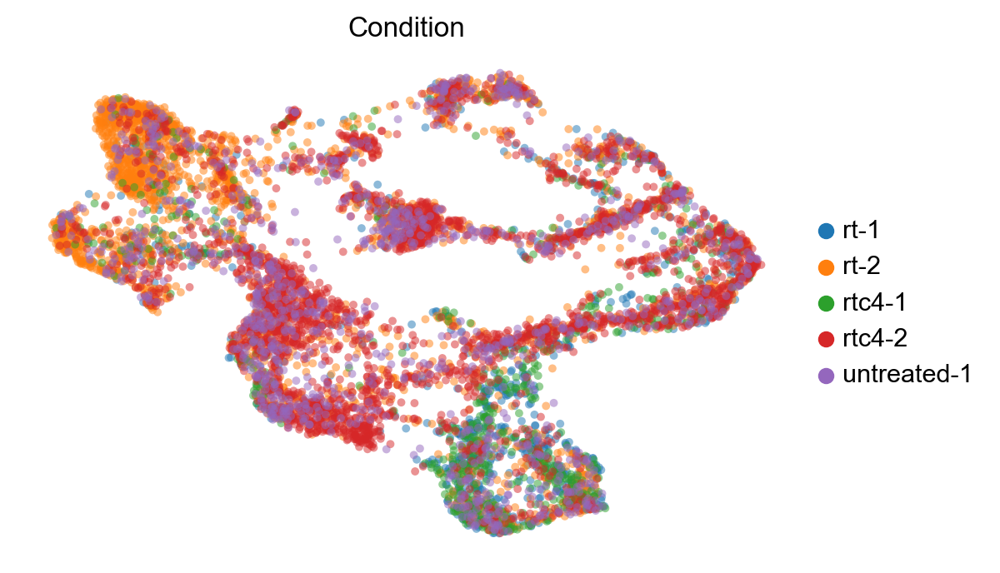

In [16]:
sc.pl.umap(sceMerge, color='orig.ident', frameon=False, legend_loc='right margin', title='Condition',
          alpha=.5,size=50)

### Filter and normalize

In [17]:
scv.pp.filter_genes(sceMerge, min_shared_counts=20)
scv.pp.normalize_per_cell(sceMerge)
scv.pp.filter_genes_dispersion(sceMerge, n_top_genes=2000)
scv.pp.log1p(sceMerge)

Filtered out 4649 genes that are detected 20 counts (shared).
Normalized count data: spliced, unspliced.
Extracted 2000 highly variable genes.


In [18]:
scv.pp.filter_and_normalize(sceMerge, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(sceMerge, n_pcs=30, n_neighbors=30)

Filtered out 81 genes that are detected 20 counts (shared).
Skip filtering by dispersion since number of variables are less than `n_top_genes`.
computing neighbors
    finished (0:00:06) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


### Compute velocities

In [19]:
scv.tl.velocity(sceMerge)

computing velocities
    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


### Compute velocity graph

In [20]:
scv.tl.velocity_graph(sceMerge)

computing velocity graph (using 1/8 cores)


  0%|          | 0/8006 [00:00<?, ?cells/s]

    finished (0:00:37) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


## Plot velocity stream

computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


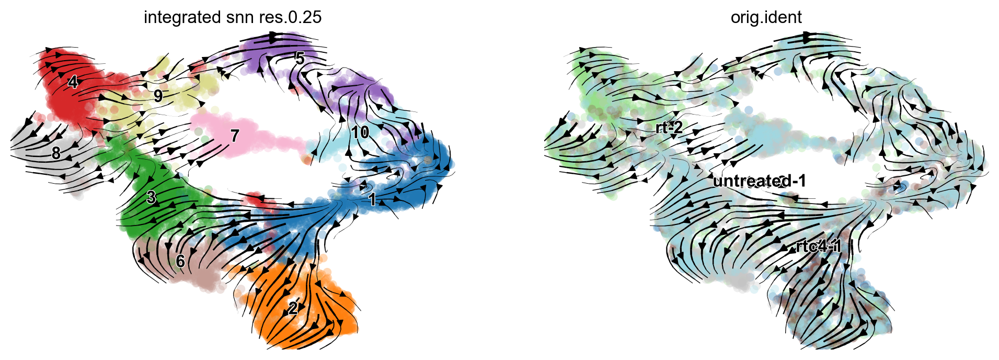

In [21]:
scv.pl.velocity_embedding_stream(sceMerge, basis='umap', color=['integrated_snn_res.0.25','orig.ident'], 
                                 palette="tab20")

## Plot individual arrows

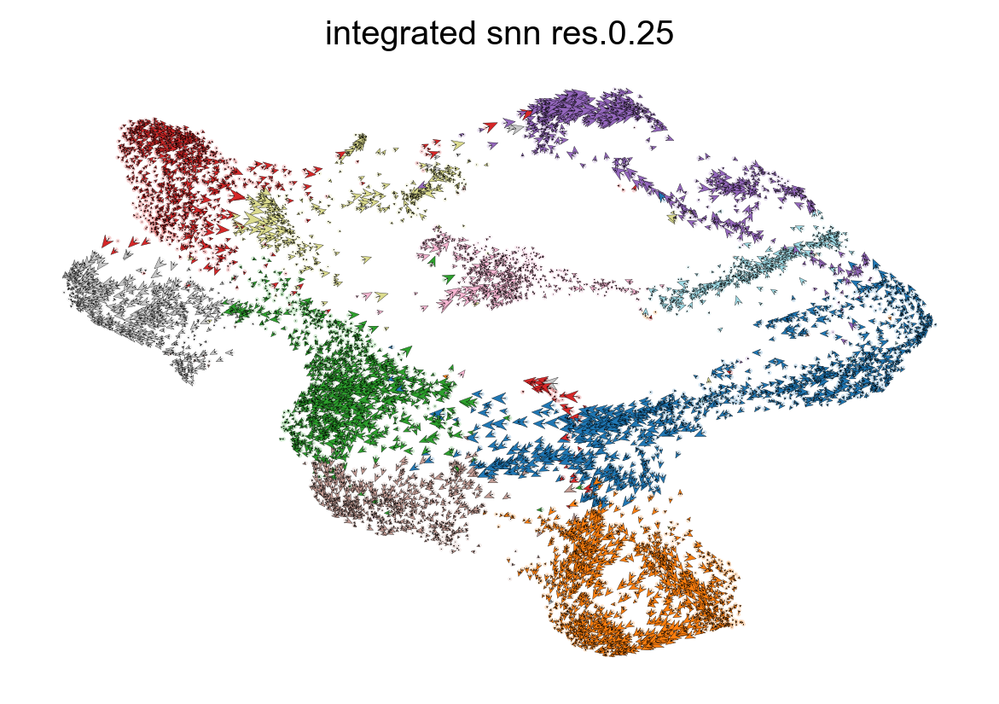

In [22]:
scv.pl.velocity_embedding(sceMerge, arrow_length=5, arrow_size=5, dpi=120, color='integrated_snn_res.0.25')

## Plot grid

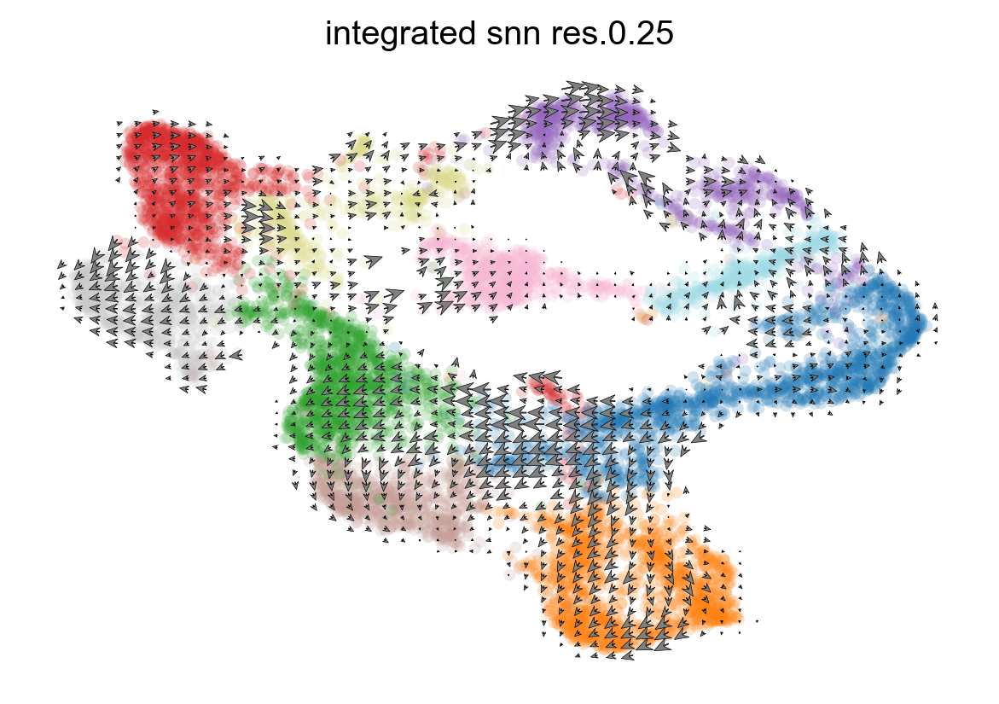

In [23]:
scv.pl.velocity_embedding_grid(sceMerge,arrow_length=3, arrow_size=3, dpi=120, color='integrated_snn_res.0.25')

## Plot velocity confidence

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


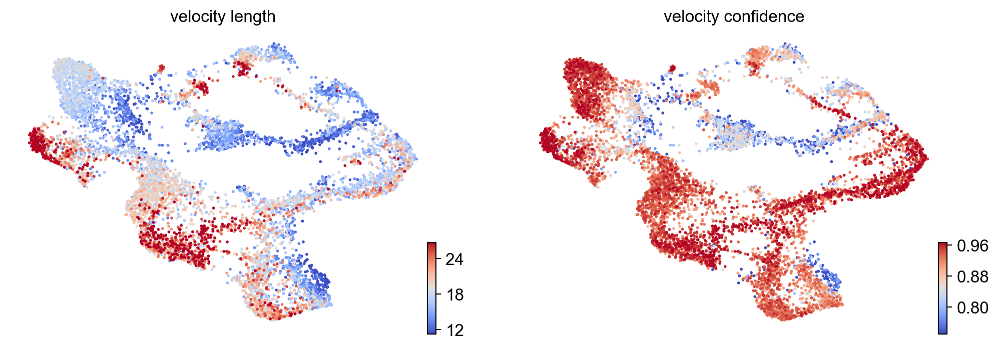

In [24]:
scv.tl.velocity_confidence(sceMerge)
keys = 'velocity_length', 'velocity_confidence'
scv.pl.scatter(sceMerge, c=keys, cmap='coolwarm', perc=[5, 95])

### Test differential Kinetics

In [25]:
var_names = ['Nt5e', 'Cd274', 'Lag3', 'Ctla4', 'Pdcd1']
scv.tl.differential_kinetic_test(sceMerge, var_names=var_names, groupby='integrated_snn_res.0.25')

recovering dynamics (using 1/8 cores)
    finished (0:00:04) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
testing for differential kinetics
    finished (0:00:01) --> added 
    'fit_diff_kinetics', clusters displaying differential kinetics (adata.var)
    'fit_pvals_kinetics', p-values of differential kinetics (adata.var)


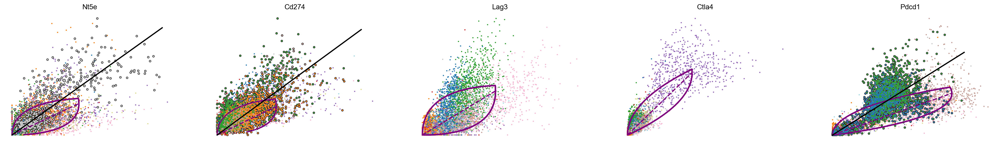

In [26]:
kwargs = dict(linewidth=2, add_linfit=True, frameon=False)
scv.pl.scatter(sceMerge, basis=var_names, add_outline='fit_diff_kinetics', **kwargs)

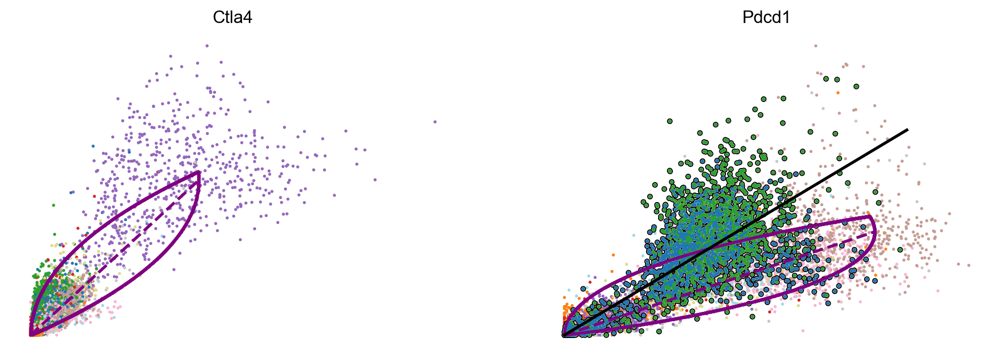

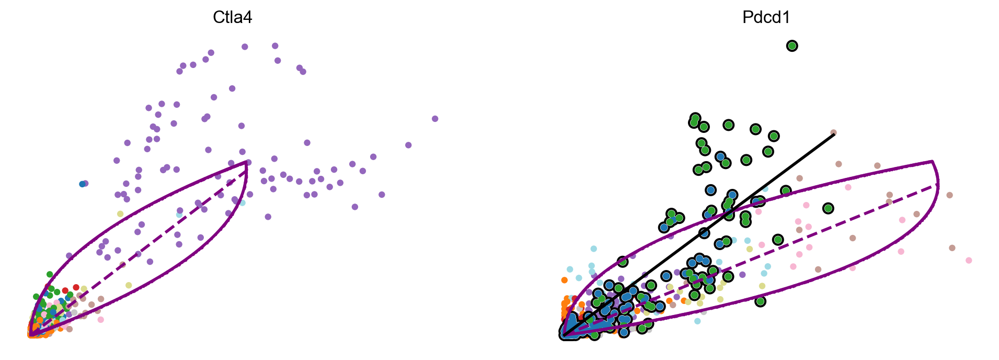

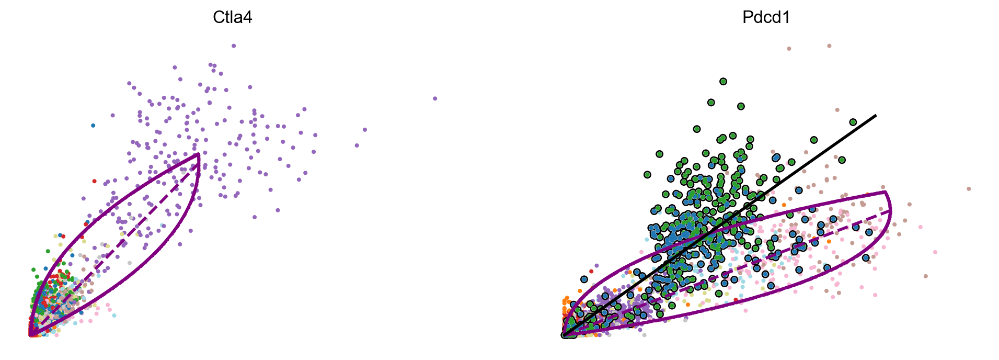

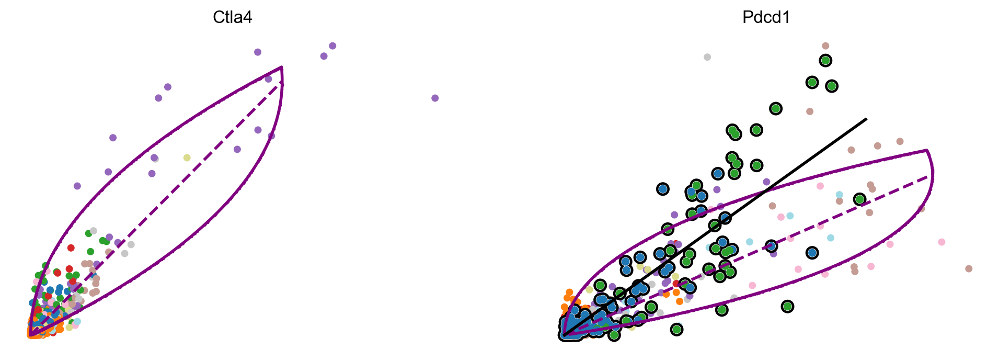

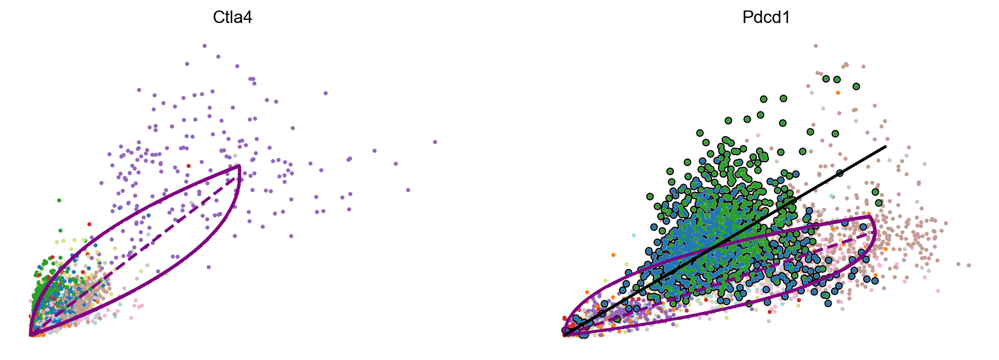

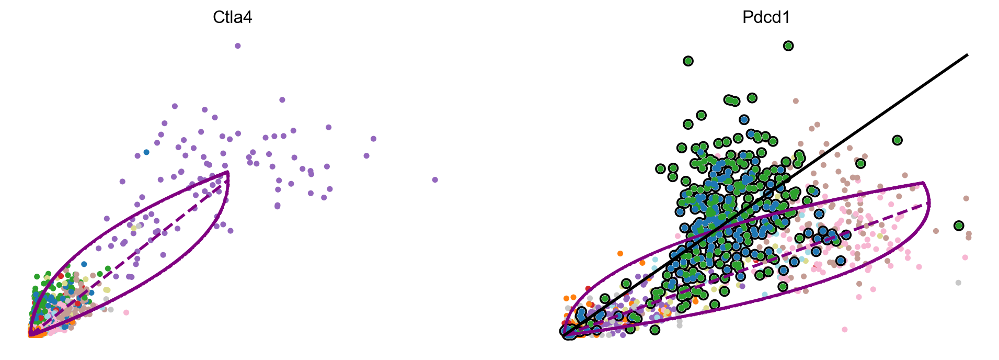

In [107]:
kwargs = dict(linewidth=2, add_linfit=True, frameon=False)
scv.pl.scatter(sceMerge, basis=var_names[3:5], add_outline='fit_diff_kinetics', **kwargs)
scv.pl.scatter(sceMerge_rt1, basis=var_names[3:5], add_outline='fit_diff_kinetics', **kwargs)
scv.pl.scatter(sceMerge_rt2, basis=var_names[3:5], add_outline='fit_diff_kinetics', **kwargs)
scv.pl.scatter(sceMerge_rtc41, basis=var_names[3:5], add_outline='fit_diff_kinetics', **kwargs)
scv.pl.scatter(sceMerge_rtc42, basis=var_names[3:5], add_outline='fit_diff_kinetics', **kwargs)
scv.pl.scatter(sceMerge_untr, basis=var_names[3:5], add_outline='fit_diff_kinetics', **kwargs)

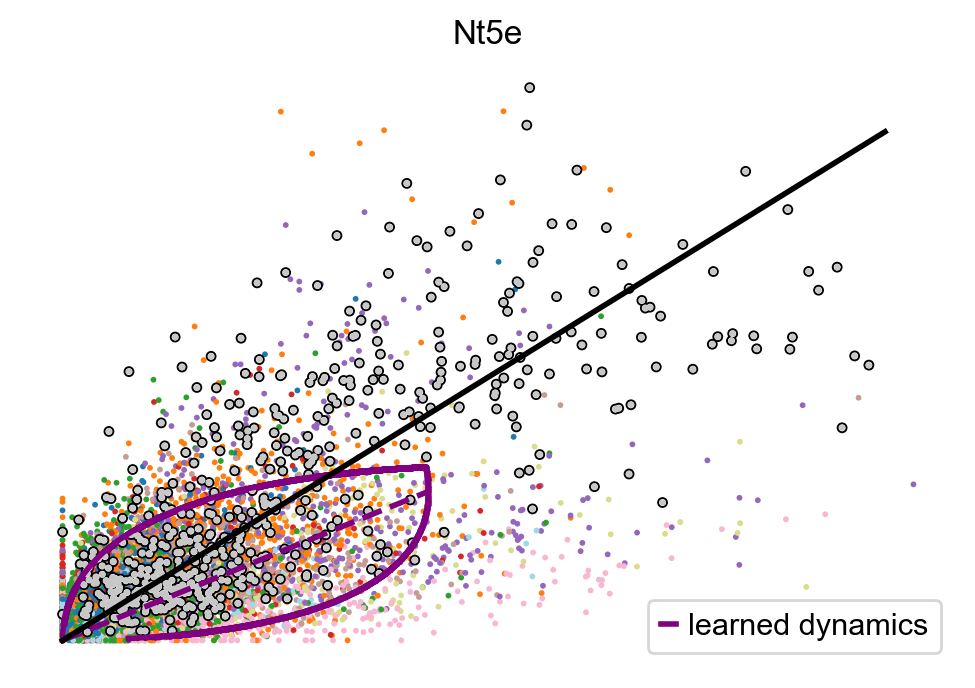

In [109]:
kwargs = dict(linewidth=2, add_linfit=True, frameon=False)
scv.pl.scatter(sceMerge, basis=var_names[0:1], add_outline='fit_diff_kinetics', **kwargs)

In [106]:
var_names[3:5]

['Ctla4', 'Pdcd1']

In [27]:
top_genes = sceMerge.var['fit_likelihood'].sort_values(ascending=False).index[:100]
scv.tl.differential_kinetic_test(sceMerge, var_names=top_genes, groupby='integrated_snn_res.0.25')


recovering dynamics (using 1/8 cores)


  0%|          | 0/95 [00:00<?, ?gene/s]

    finished (0:00:40) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
testing for differential kinetics
    finished (0:00:25) --> added 
    'fit_diff_kinetics', clusters displaying differential kinetics (adata.var)
    'fit_pvals_kinetics', p-values of differential kinetics (adata.var)


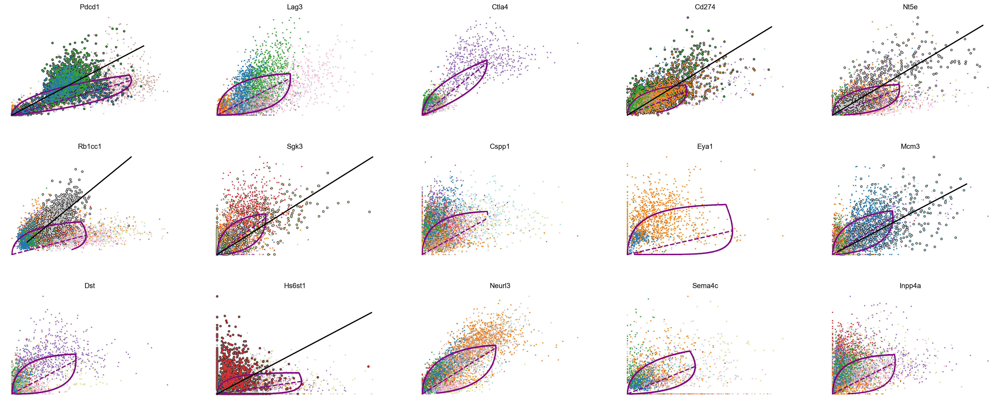

In [28]:
scv.pl.scatter(sceMerge, basis=top_genes[:15], ncols=5, add_outline='fit_diff_kinetics', **kwargs)

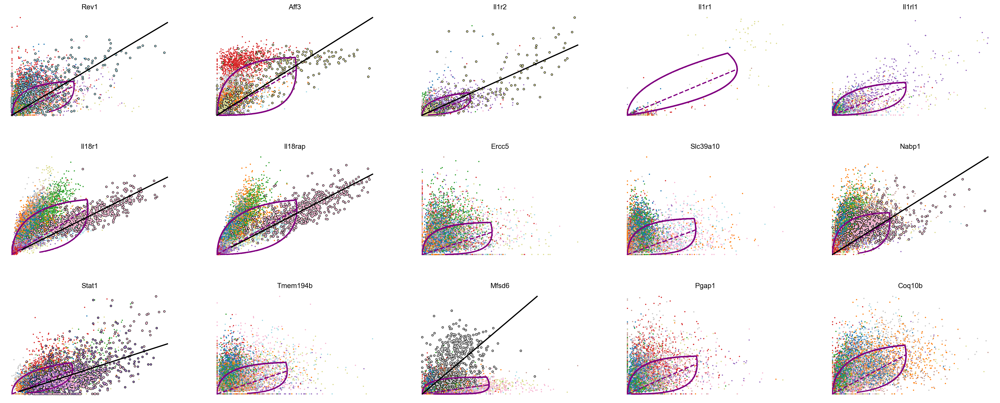

In [29]:
scv.pl.scatter(sceMerge, basis=top_genes[15:30], ncols=5, add_outline='fit_diff_kinetics', **kwargs)

In [30]:
scv.tl.velocity(sceMerge, diff_kinetics=True)
scv.tl.velocity_graph(sceMerge)

computing velocities
    finished (0:00:03) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/8 cores)


  0%|          | 0/8006 [00:00<?, ?cells/s]

    finished (0:00:38) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


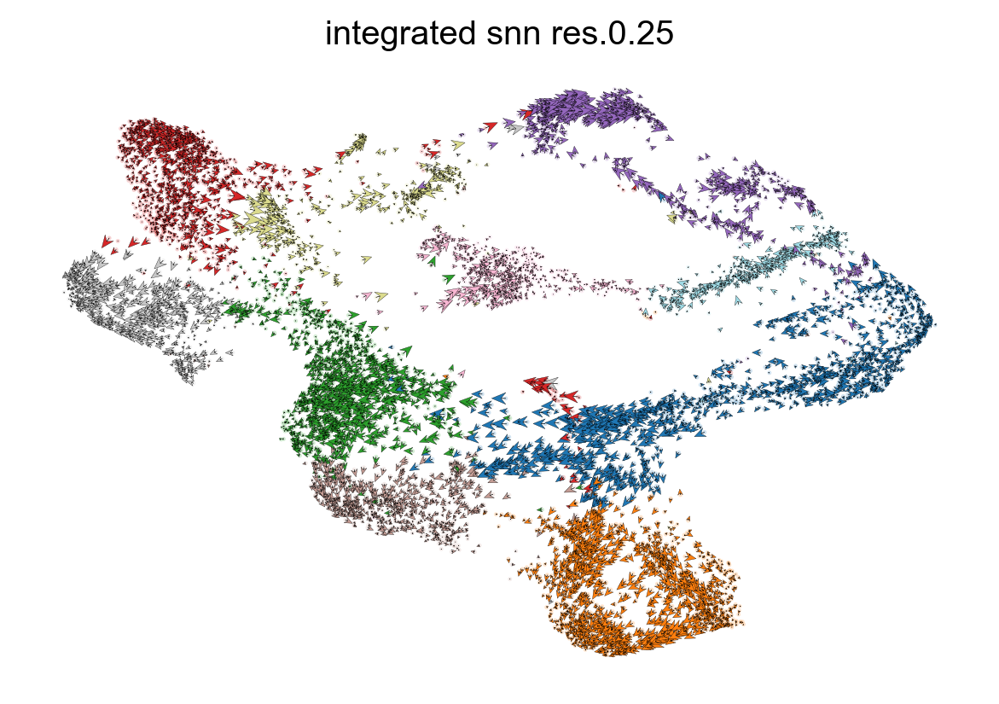

In [31]:
scv.pl.velocity_embedding(sceMerge, arrow_length=5, arrow_size=5, dpi=120, color='integrated_snn_res.0.25')

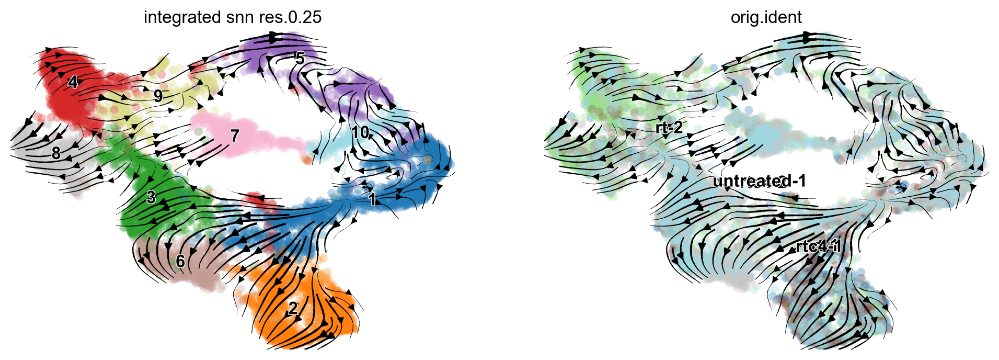

In [33]:
scv.pl.velocity_embedding_stream(sceMerge, basis='umap', color=["integrated_snn_res.0.25", "orig.ident"])

saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/All_res025_stream.png


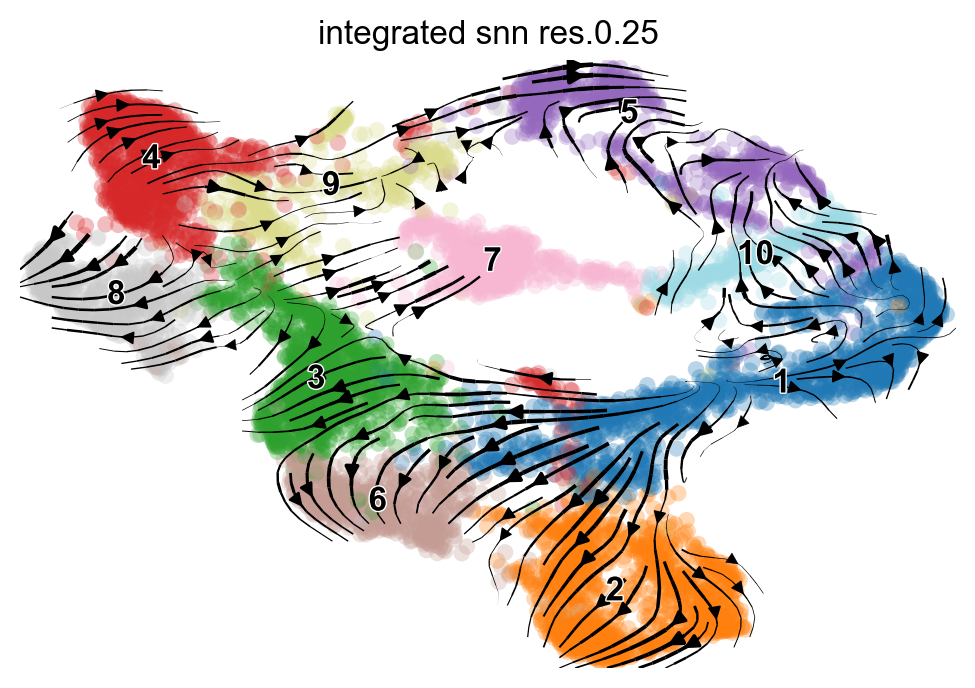

In [34]:
scv.pl.velocity_embedding_stream(sceMerge, basis='umap', color=["integrated_snn_res.0.25"],
                                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/All_res025_stream.png')

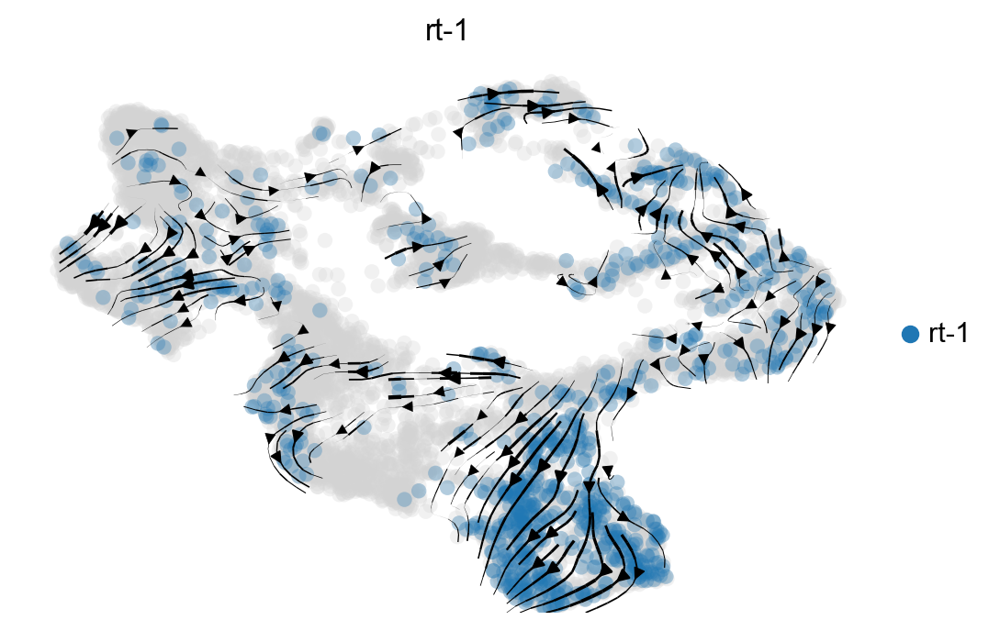

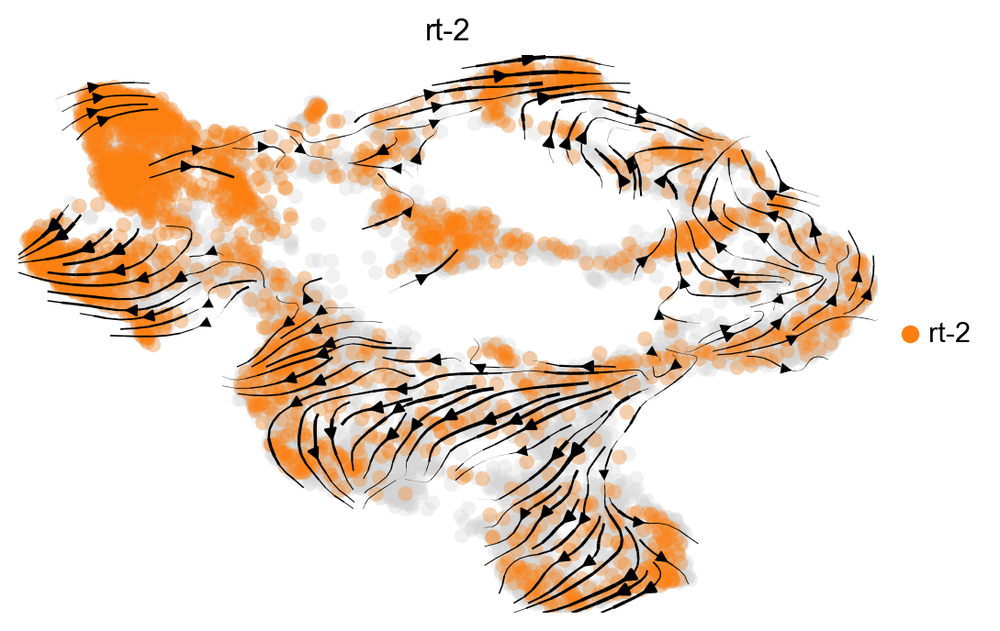

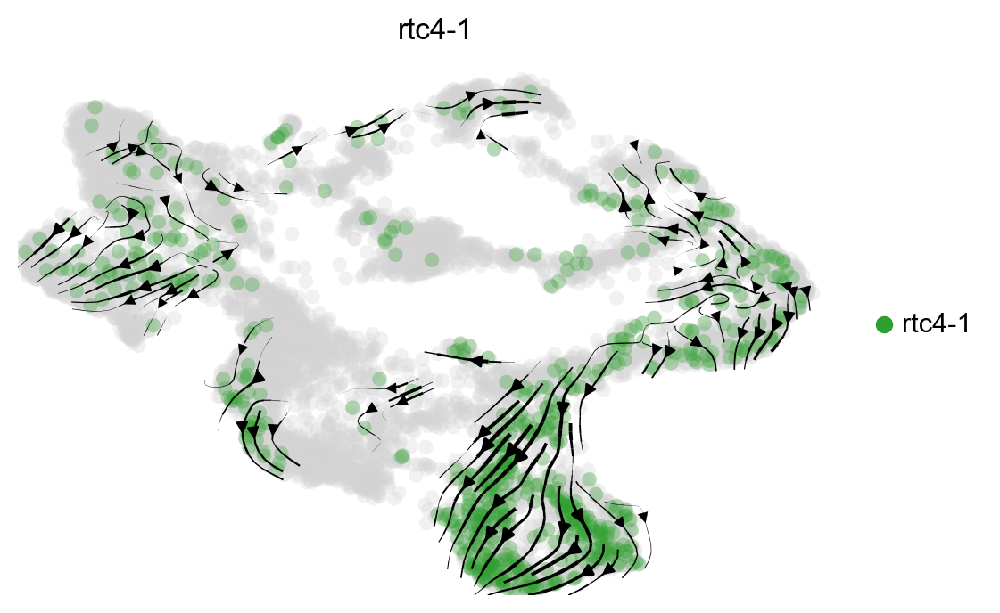

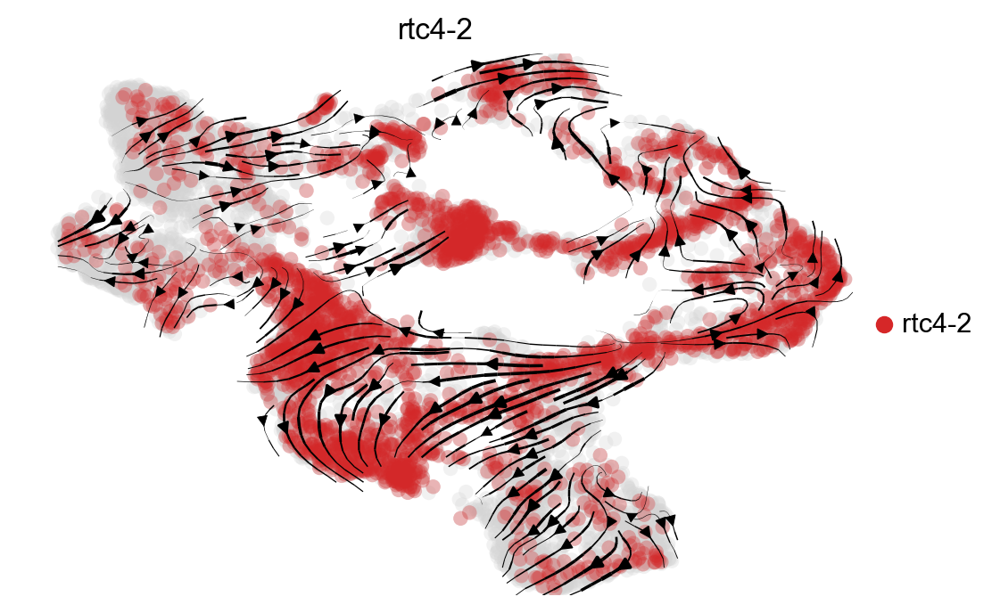

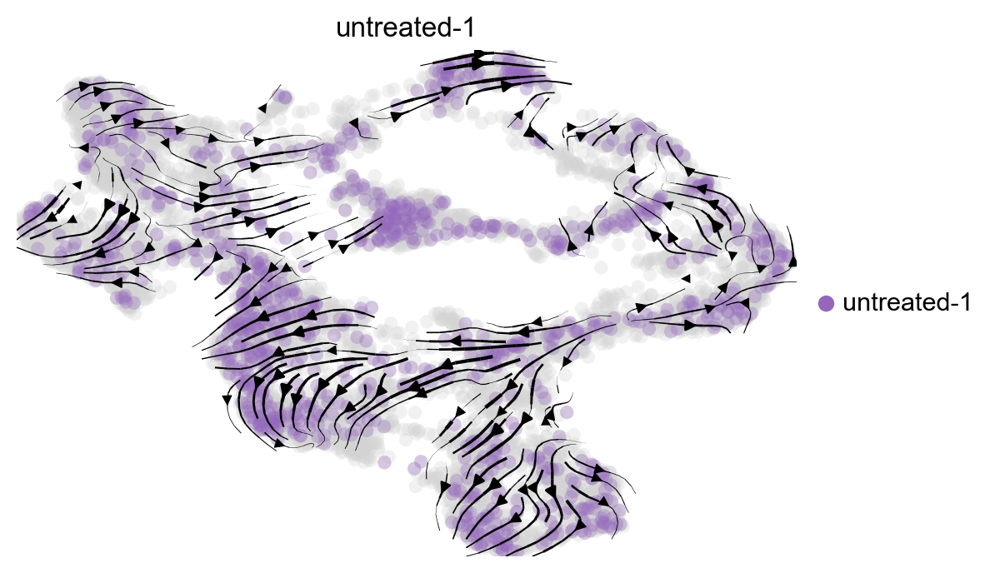

In [35]:
scv.pl.velocity_embedding_stream(sceMerge, basis='umap', color='orig.ident', groups='rt-1', legend_loc='right margin'
                                ,palette='top20')
scv.pl.velocity_embedding_stream(sceMerge, basis='umap', color='orig.ident', groups='rt-2', legend_loc='right margin'
                                ,palette='top20')
scv.pl.velocity_embedding_stream(sceMerge, basis='umap', color='orig.ident', groups='rtc4-1', legend_loc='right margin'
                                ,palette='top20')
scv.pl.velocity_embedding_stream(sceMerge, basis='umap', color='orig.ident', groups='rtc4-2', legend_loc='right margin'
                                ,palette='top20')
scv.pl.velocity_embedding_stream(sceMerge, basis='umap', color='orig.ident', groups='untreated-1', legend_loc='right margin'
                                ,palette='top20')

In [37]:
scv.pl.velocity_embedding_stream(sceMerge[(sceMerge.obs['orig.ident']=='rt-1')], basis='umap', 
                                 legend_loc='right margin',
                                 color=['integrated_snn_res.0.25'], size =200, title = 'rt-1', show=False,
                                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt1_res025_stream.png')
scv.pl.velocity_embedding_stream(sceMerge[(sceMerge.obs['orig.ident']=='rt-2')], basis='umap',  
                                 legend_loc='right margin',
                                 color=['integrated_snn_res.0.25'], size =200, title = 'rt-2', show=False,
                                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt2_res025_stream.png')
scv.pl.velocity_embedding_stream(sceMerge[(sceMerge.obs['orig.ident']=='rtc4-1')], basis='umap', 
                                 legend_loc='right margin', 
                                 color=['integrated_snn_res.0.25'], size =200, title = 'rtc4-1', show=False,
                                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt41_res025_stream.png')
scv.pl.velocity_embedding_stream(sceMerge[(sceMerge.obs['orig.ident']=='rtc4-2')], basis='umap', 
                                 legend_loc='right margin', 
                                 color=['integrated_snn_res.0.25'], size =200, title = 'rtc4-2', show=False,
                                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt42_res025_stream.png')
scv.pl.velocity_embedding_stream(sceMerge[(sceMerge.obs['orig.ident']=='untreated-1')], basis='umap',  
                                 legend_loc='right margin',
                                 color=['integrated_snn_res.0.25'], size =200, title = 'untreated', show=False,
                                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/untreated_res025_stream.png')

saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt1_res025_stream.png
saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt2_res025_stream.png
saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt41_res025_stream.png
saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt42_res025_stream.png
saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/untreated_res025_stream.png


<AxesSubplot:title={'center':'untreated'}>

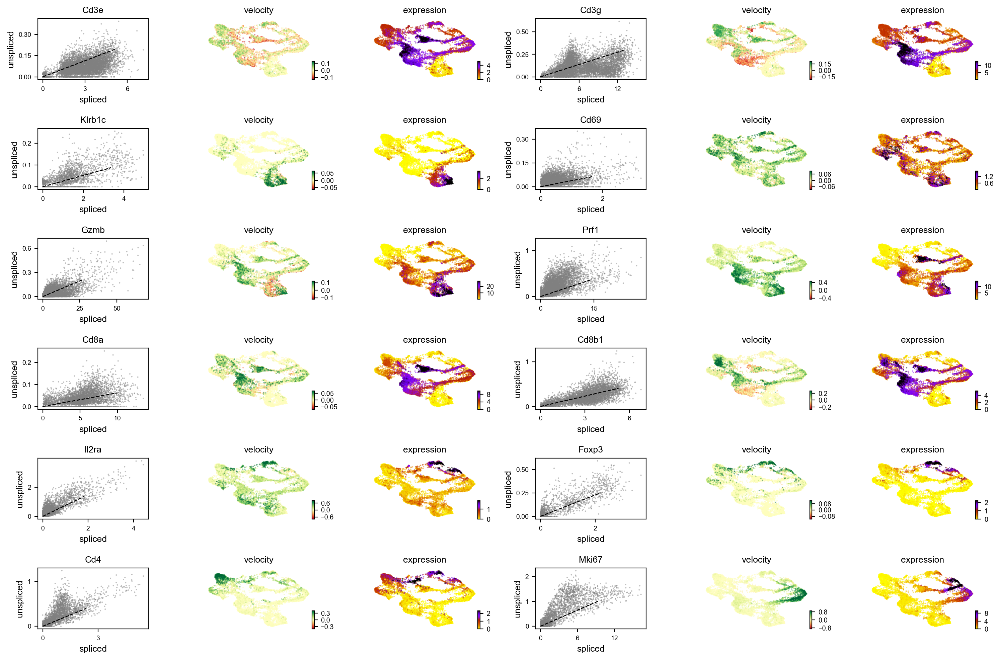

In [38]:
scv.pl.velocity(sceMerge, ['Cd3e', 'Cd3g', 'Klrb1c', 'Cd69', 'Gzmb', 'Prf1',  'Cd8a', 'Cd8b1',
                           'Il2ra', 'Foxp3', 'Cd4', 'Mki67'], ncols=2)

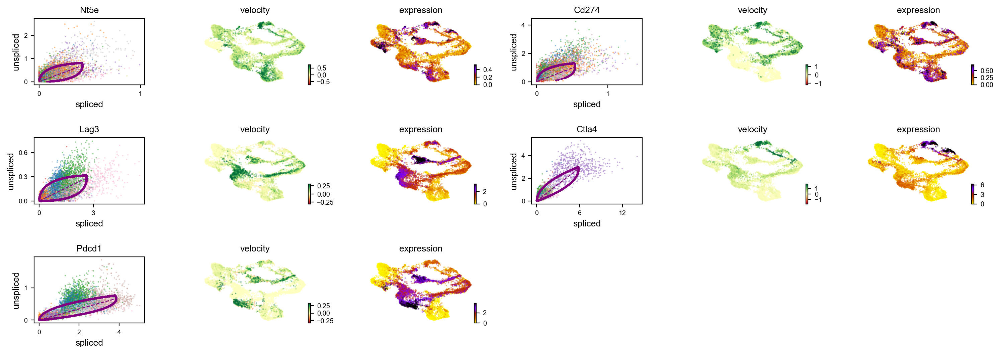

In [89]:
scv.pl.velocity(sceMerge, ['Nt5e', 'Cd274', 'Lag3', 'Ctla4', 'Pdcd1'], ncols=2, color='integrated_snn_res.0.25'
                )

In [40]:
gene=["Ctsw", "Klrg1", "Ifng", "Nkg7" , "Klrb1a","Klrb1","Klrb1c","Gm44511","Klrb1b" ,
"Klrb1f", "Fasl", "Gzme", "Gzmd",  "Gzmg","Gzmn","Gzmf","Gzmc","Gzmb",
"Gzmm", "Gzmk", "Gzma", "Tnfsf10","Prf1","Cst7","Ccl3"]
scv.pl.velocity(sceMerge[(sceMerge.obs['orig.ident']=='rt-1')],gene, ncols=2, size=20, show=False,
                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt-1_Cyto.pdf')
scv.pl.velocity(sceMerge[(sceMerge.obs['orig.ident']=='rt-2')],gene, ncols=2, size=20,
                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt-2_Cyto.pdf', show=False)
scv.pl.velocity(sceMerge[(sceMerge.obs['orig.ident']=='rtc4-1')],gene, ncols=2, size=20,
                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rtc41_Cyto.pdf', show=False)
scv.pl.velocity(sceMerge[(sceMerge.obs['orig.ident']=='rtc4-2')],gene, ncols=2, size=20,
                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rtc42_Cyto.pdf', show=False)
scv.pl.velocity(sceMerge[(sceMerge.obs['orig.ident']=='untreated-1')],gene, ncols=2, size=20,
                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/untreated_Cyto.pdf', show=False)

Trying to set attribute `.layers` of view, copying.
Trying to set attribute `.layers` of view, copying.


saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt-1_Cyto.pdf


Trying to set attribute `.layers` of view, copying.


saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt-2_Cyto.pdf


Trying to set attribute `.layers` of view, copying.


saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rtc41_Cyto.pdf


Trying to set attribute `.layers` of view, copying.


saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rtc42_Cyto.pdf
saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/untreated_Cyto.pdf


<AxesSubplot:title={'center':'expression'}>

In [41]:
gene1=["Ctsw", "Klrg1", "Ifng", "Nkg7" , "Klrb1a","Klrb1","Klrb1c","Gm44511","Klrb1b" ,
"Klrb1f", "Fasl", "Gzme", "Gzmd",  "Gzmg","Gzmn","Gzmf","Gzmc","Gzmb",
"Gzmm", "Gzmk", "Gzma", "Tnfsf10","Prf1","Cst7","Ccl3"]

scv.pl.velocity(sceMerge,gene, ncols=2, size=20, 
                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/all_Cyto.pdf', show=False)

gene2 = ["Cd80","Cd83","Tigit","Klrg1","Btla","Id2","Prdm1","Lag3","Clec2m","Klre1","Klrc3","Klrc2","Klrc1","Klri1",
      "Klri2","Klrh1","Havcr2","Fasl","Klrd1","Ctla4","Pdcd1","Tbx21","Zbtb32"]

scv.pl.velocity(sceMerge,gene, ncols=2, size=20, 
                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/all_ActExh.pdf', show=False)

saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/all_Cyto.pdf
saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/all_ActExh.pdf


<AxesSubplot:title={'center':'expression'}>

In [42]:
gene = ["Cd80","Cd83","Tigit","Klrg1","Btla","Id2","Prdm1","Lag3","Clec2m","Klre1","Klrc3","Klrc2","Klrc1","Klri1",
      "Klri2","Klrh1","Havcr2","Fasl","Klrd1","Ctla4","Pdcd1","Tbx21","Zbtb32"]

scv.pl.velocity(sceMerge[(sceMerge.obs['orig.ident']=='rt-1')],gene, ncols=2, size=20, show=False,
                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt-1_ActExh.pdf')
scv.pl.velocity(sceMerge[(sceMerge.obs['orig.ident']=='rt-2')],gene, ncols=2, size=20, show=False,
                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt-2_ActExh.pdf')
scv.pl.velocity(sceMerge[(sceMerge.obs['orig.ident']=='rtc4-1')],gene, ncols=2, size=20, show=False,
                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rtc4-1_ActExh.pdf')
scv.pl.velocity(sceMerge[(sceMerge.obs['orig.ident']=='rtc4-2')],gene, ncols=2, size=20, show=False,
                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rtc4-2_ActExh.pdf')
scv.pl.velocity(sceMerge[(sceMerge.obs['orig.ident']=='untreated-1')],gene, ncols=2, size=20, show=False,
                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/untreated_ActExh.pdf')

Trying to set attribute `.layers` of view, copying.
Trying to set attribute `.layers` of view, copying.


saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt-1_ActExh.pdf


Trying to set attribute `.layers` of view, copying.


saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt-2_ActExh.pdf


Trying to set attribute `.layers` of view, copying.


saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rtc4-1_ActExh.pdf


Trying to set attribute `.layers` of view, copying.


saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rtc4-2_ActExh.pdf
saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/untreated_ActExh.pdf


<AxesSubplot:title={'center':'expression'}>

## Estimate Cell states and transitions

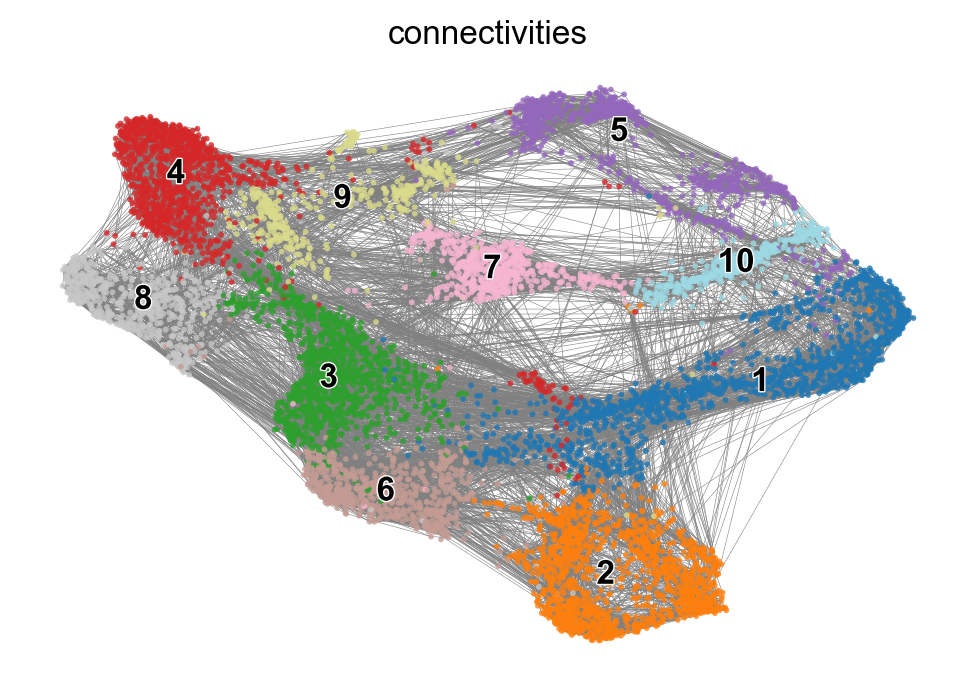

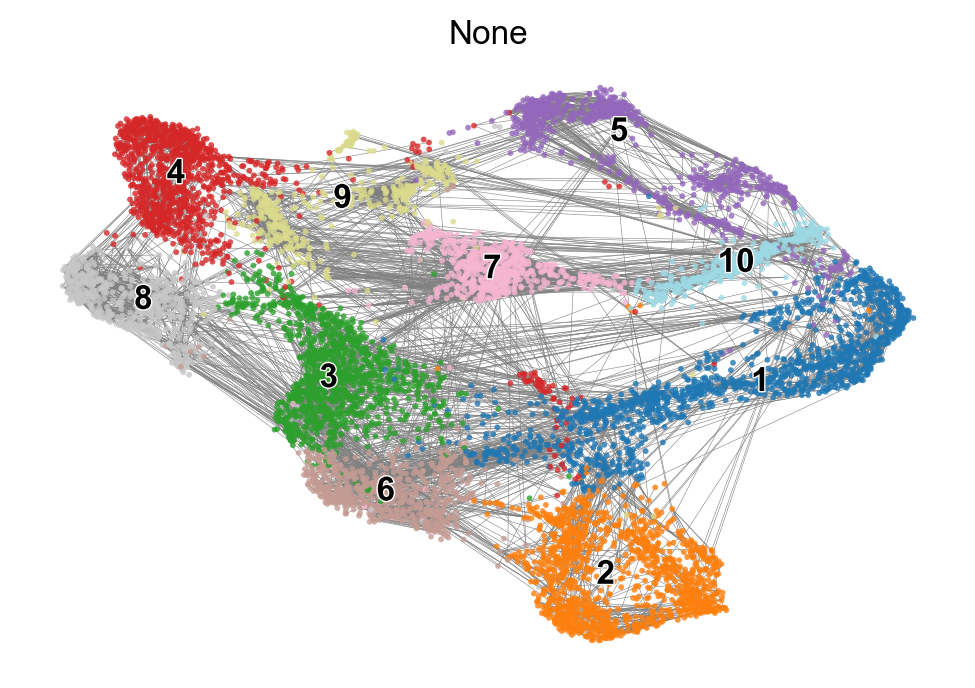

In [43]:
scv.pl.velocity_graph(sceMerge, threshold=.4, color="integrated_snn_res.0.25", which_graph='connectivities')
scv.pl.velocity_graph(sceMerge, threshold=.2, color="integrated_snn_res.0.25", which_graph='None')

In [44]:
scv.pl.velocity_graph(sceMerge, threshold=.1, color="orig.ident", groups="rt-1", show=False,
                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt-1_trans_none.pdf')
scv.pl.velocity_graph(sceMerge, threshold=.1, color="orig.ident", groups="rt-2",show=False,
                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt-2_trans_none.pdf')
scv.pl.velocity_graph(sceMerge, threshold=.1, color="orig.ident", groups="rtc4-1",show=False,
                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rtc4-1_trans_none.pdf')
scv.pl.velocity_graph(sceMerge, threshold=.1, color="orig.ident", groups="rtc4-2",show=False,
                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rtc4-2_trans_none.pdf')
scv.pl.velocity_graph(sceMerge, threshold=.1, color="orig.ident", groups="untreated-1",show=False,
                save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/untreated_trans_none.pdf')

saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt-1_trans_none.pdf
saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt-2_trans_none.pdf
saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rtc4-1_trans_none.pdf
saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rtc4-2_trans_none.pdf
saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/untreated_trans_none.pdf


<AxesSubplot:title={'center':'untreated-1'}>

In [45]:
scv.pl.velocity_graph(sceMerge, threshold=.25, color="orig.ident", groups="rt-1", which_graph='connectivities',
                     show=False, 
                      save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt-1_trans_connectivities.pdf')
scv.pl.velocity_graph(sceMerge, threshold=.25, color="orig.ident", groups="rt-2", which_graph='connectivities',
                     show=False, 
                      save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt-2_trans_connectivities.pdf')
scv.pl.velocity_graph(sceMerge, threshold=.25, color="orig.ident", groups="rtc4-1", which_graph='connectivities',
                     show=False, 
                      save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rtc4-1_trans_connectivities.pdf')
scv.pl.velocity_graph(sceMerge, threshold=.25, color="orig.ident", groups="rtc4-2", which_graph='connectivities',
                     show=False, 
                      save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rtc4-2_trans_connectivities.pdf')
scv.pl.velocity_graph(sceMerge, threshold=.25, color="orig.ident", groups="untreated-1", which_graph='connectivities',
                     show=False, 
                      save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/untreated_trans_connectivities.pdf')

saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt-1_trans_connectivities.pdf
saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rt-2_trans_connectivities.pdf
saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rtc4-1_trans_connectivities.pdf
saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/rtc4-2_trans_connectivities.pdf
saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/untreated_trans_connectivities.pdf


<AxesSubplot:title={'center':'connectivities'}>

computing terminal states
    identified 0 region of root cells and 3 regions of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


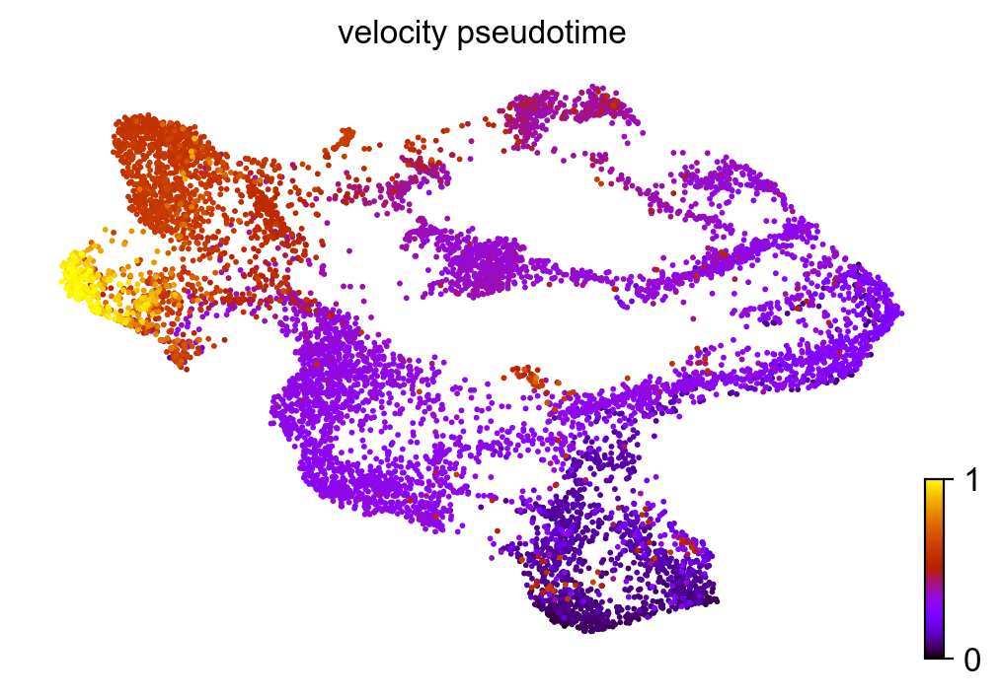

In [46]:
scv.tl.velocity_pseudotime(sceMerge)
scv.pl.scatter(sceMerge, color='velocity_pseudotime', cmap='gnuplot')

## Run PAGA and Plot

In [47]:
# this is needed due to a current bug - bugfix is coming soon.
sceMerge.uns['neighbors']['distances'] = sceMerge.obsp['distances']
sceMerge.uns['neighbors']['connectivities'] = sceMerge.obsp['connectivities']

scv.tl.paga(sceMerge, groups='integrated_snn_res.0.25')
df = scv.get_df(sceMerge, 'paga/transitions_confidence', precision=2).T
df.style.background_gradient(cmap='Blues').format('{:.2g}')

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:01) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


,0,1,2,3,4,5,6,7,8,9
0,0,0,0.19,0,0,0.16,0,0,0,0
1,0.017,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0.069,0,0,0
3,0,0,0,0,0,0,0,0.19,0,0
4,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0.12,0
7,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0.28,0,0,0,0,0,0
9,0,0,0,0,0.052,0,0.61,0,0,0


saving figure to file /Users/Oliver.Eichmueller/velocyto_test/plots_TCells/PAGA_all_025.pdf


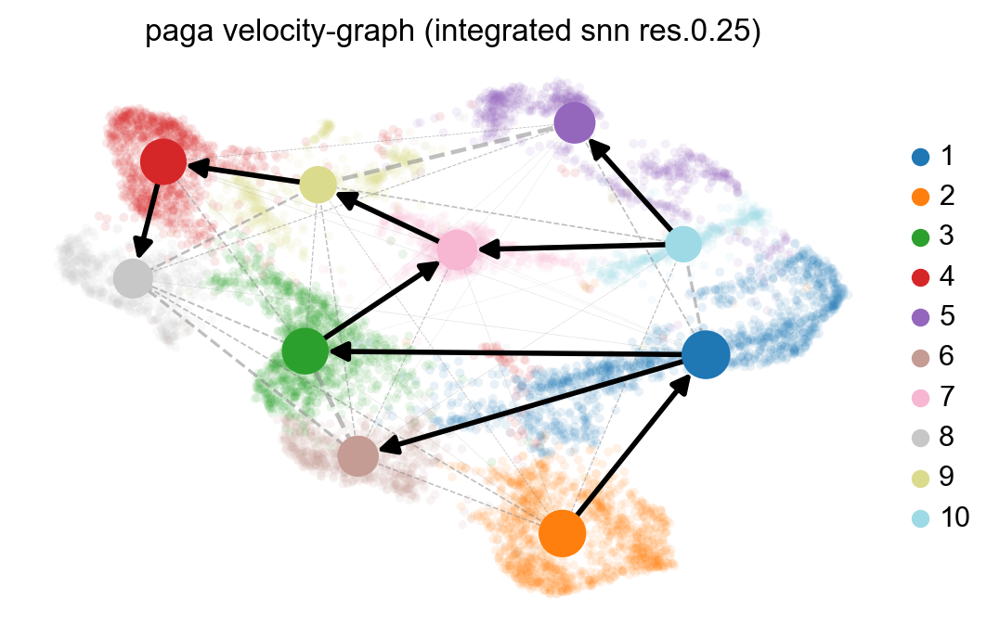

In [48]:
scv.pl.paga(sceMerge, basis='umap', size=50, alpha=.1,
            min_edge_width=2, node_size_scale=1.5, save='/Users/Oliver.Eichmueller/velocyto_test/plots_TCells/PAGA_all_025.pdf')

In [49]:
sceMerge.write_h5ad("/Users/Oliver.Eichmueller/velocyto_test/filtered_Tcells_211028.h5ad")

In [50]:
# sceMerge = scv.read("/Users/Oliver.Eichmueller/velocyto_test/filtered_Tcells_211028.h5ad")